In [2]:
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.regularizers import l2
import os

## Reading data from the directory and creating datasets

In [3]:
import pathlib
data_dir = '.\\practise\\images\\People\\data_sets_2\\train_dataset'
data_dir = pathlib.Path(data_dir)
test_dir = '.\\practise\\images\\People\\data_sets_2\\test_dataset'
test_dir = pathlib.Path(test_dir)

In [4]:
IMG_SIZE = (224,224)
BATCH_SIZE = 16

In [5]:
train_dataset = tf.keras.utils.image_dataset_from_directory(data_dir,
                                                            shuffle=True,
                                                            batch_size=BATCH_SIZE,
                                                            validation_split=0,
                                                            image_size=IMG_SIZE)
validation_dataset =  tf.keras.utils.image_dataset_from_directory(test_dir,
                                                                 shuffle=True,
                                                                 validation_split=0,
                                                                 batch_size=BATCH_SIZE,
                                                                 image_size=IMG_SIZE)

Found 6000 files belonging to 3 classes.
Found 3597 files belonging to 3 classes.


['Multiple_People', 'No_People', 'Single_Person']


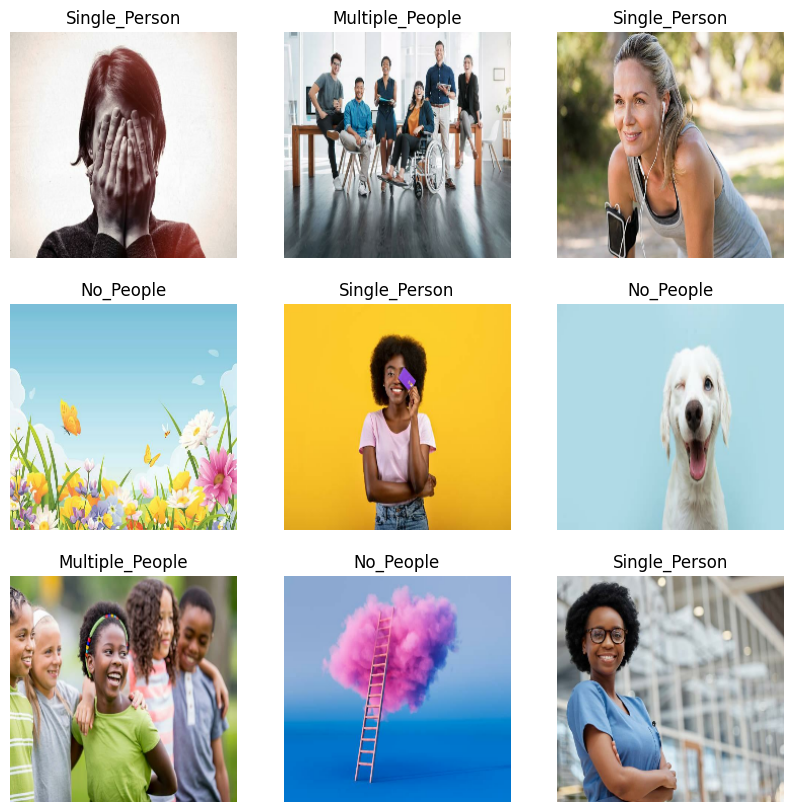

In [6]:
print(train_dataset.class_names)
class_names = train_dataset.class_names

plt.figure(figsize=(10, 10))
for images, labels in train_dataset.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [7]:
val_batches = tf.data.experimental.cardinality(validation_dataset)
test_dataset = validation_dataset.take(val_batches // 5)
validation_dataset = validation_dataset.skip(val_batches // 5)

print('Number of validation batches: %d' % tf.data.experimental.cardinality(validation_dataset))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_dataset))

Number of validation batches: 180
Number of test batches: 45


In [8]:
AUTOTUNE = tf.data.AUTOTUNE

train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.prefetch(buffer_size=AUTOTUNE)
test_dataset = test_dataset.prefetch(buffer_size=AUTOTUNE)

## Defining layers in the model

In [9]:
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomFlip('horizontal'),
  tf.keras.layers.RandomRotation(0.2),
])

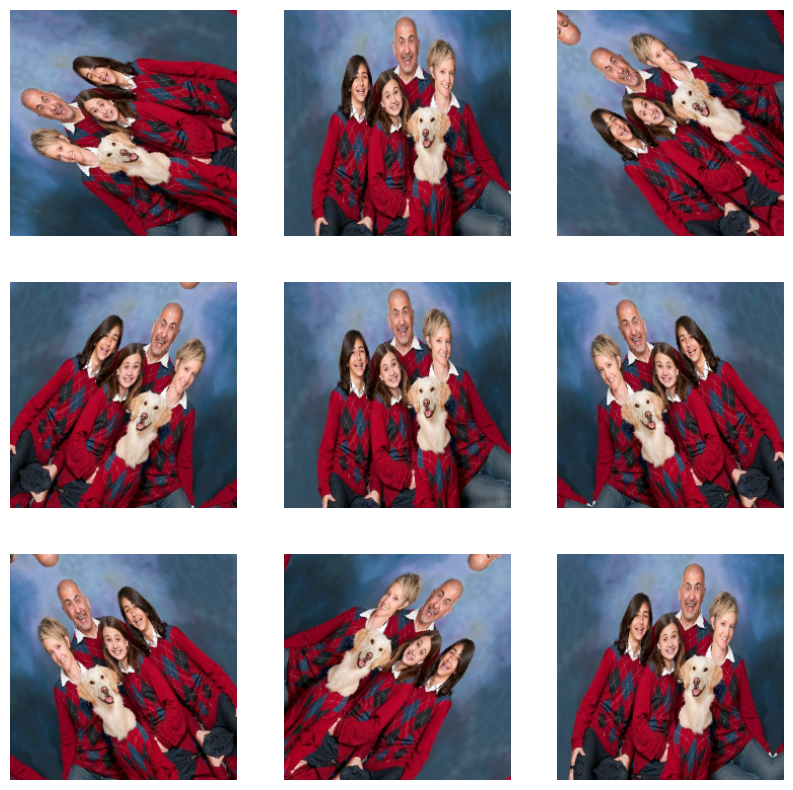

In [10]:
for image, _ in train_dataset.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

In [11]:
normalization_layer = tf.keras.layers.Rescaling(1./255)

In [12]:
IMG_SHAPE = IMG_SIZE + (3,)
base_model = tf.keras.applications.ResNet50V2(
    input_shape=IMG_SHAPE,
    include_top=False,
    weights="imagenet",
)


In [13]:
base_model.trainable = False

In [ ]:
# If needed you can uncomment this and run 
# base_model.summary()

In [14]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()

In [15]:
prediction_layer = tf.keras.layers.Dense(3,kernel_regularizer=l2(0.001))

In [16]:
inputs = tf.keras.Input(shape=(224, 224, 3))
x = data_augmentation(inputs)
x = normalization_layer(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(1024,activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(512,activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(256,activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
outputs = prediction_layer(x)
model = tf.keras.Model(inputs, outputs)

In [17]:
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential (Sequential)         │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling (Rescaling)           │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50v2 (Functional)         │ (None, 7, 7, 2048)     │    23,564,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1024)           │     2,098,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 3)              │           771 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,319,875 (100.40 MB)

 Trainable params: 2,755,075 (10.51 MB)

 Non-trainable params: 23,564,800 (89.89 MB)

In [18]:
len(model.trainable_variables) # lets check the number of trainable variables in the model

8

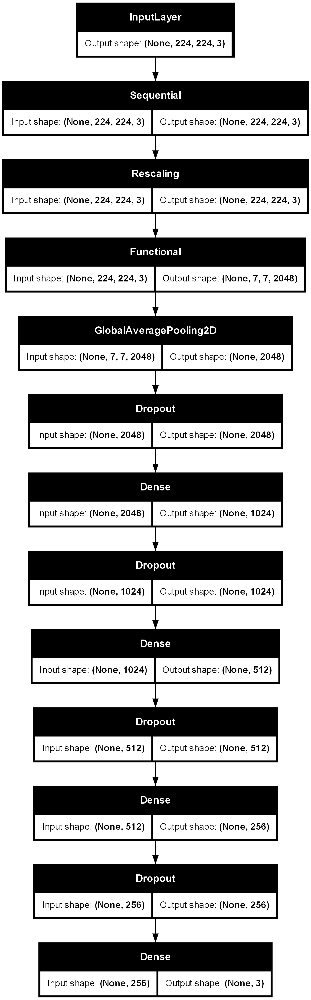

In [19]:
tf.keras.utils.plot_model(model, show_shapes=True)

## Fine tuning the layers of the base model and training our model

In [20]:
fine_tune_at = 121 # choose the layer from which you want to tune the base model

for layer in base_model.layers[fine_tune_at:]:
  layer.trainable = True

In [21]:
cnt = 0 #just checking number of trainable layers in the base model
for layer in base_model.layers:
    if layer.trainable :
        cnt+=1

print(cnt)

69


In [22]:
base_learning_rate = 0.00009
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

## Defining the model and weight checkpoint paths

In [23]:

# Include the epoch in the file name (uses `str.format`)
checkpoint_path = "mypoints/cp-{epoch:04d}.weights.h5"
checkpoint_dir = os.path.dirname(checkpoint_path)
print(checkpoint_dir)


mypoints


In [24]:
# saving the weights for the best validation accuracy seen so far
cp_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path, 
    verbose=1, 
    save_weights_only=True,
     monitor='val_accuracy',
    save_best_only=True,
    mode='max')

In [25]:
# saving the model with the best validation accuracy seen so far
model_path = 'people_model.keras'
model_callback =tf.keras.callbacks. ModelCheckpoint(
    filepath=model_path,
    monitor='val_accuracy',
    save_best_only=True,
    mode='max',
    verbose=1
)

## Training the model

You can either increase the number of epochs or run multiple training sessions by loading the weights for the "best validation accuaracy" in the previous session .I followed the second method. You can may need to decrease the learning rate , change the count of trainable layers in the base model and then recomplile your model before proceeding to the next training session.

In [ ]:
history = model.fit(train_dataset,
                    epochs=10,callbacks=[cp_callback,model_callback],
                    validation_data=validation_dataset)

In [29]:
model.load_weights('mypoints/cp-0004.weights.h5')

In [30]:
model.evaluate(validation_dataset)

180/180 ━━━━━━━━━━━━━━━━━━━━ 137s 743ms/step - accuracy: 0.9629 - loss: 0.1465


[0.1532556265592575, 0.9614181518554688]

In [ ]:
history2 = model.fit(train_dataset,initial_epoch=len(history.epoch),
                    epochs=16,callbacks=[cp_callback,model_callback],
                    validation_data=validation_dataset)

In [31]:
final_model = tf.keras.models.load_model('people_model.keras')

In [32]:
final_model.evaluate(validation_dataset) ## final validation accuracy

180/180 ━━━━━━━━━━━━━━━━━━━━ 141s 765ms/step - accuracy: 0.9708 - loss: 0.1395


[0.15685729682445526, 0.9680222272872925]

In [42]:
final_model.evaluate(test_dataset) #final test accuracy

45/45 ━━━━━━━━━━━━━━━━━━━━ 53s 1s/step - accuracy: 0.9835 - loss: 0.0703


[0.12414244562387466, 0.9722222089767456]

In [33]:
image_batch, label_batch = test_dataset.as_numpy_iterator().next()
predictions = final_model.predict_on_batch(image_batch)

In [34]:
score = tf.nn.softmax(predictions)

p=[]
confidence=[]

In [35]:
for i in score:
    p.append(np.argmax(i))
    confidence.append(np.max(i)*100)

In [36]:
print(p)

[0, 1, 2, 0, 0, 2, 1, 2, 0, 1, 2, 1, 2, 1, 0, 2]


Predictions:
 [0, 1, 2, 0, 0, 2, 1, 2, 0, 1, 2, 1, 2, 1, 0, 2]
Labels:
 [0, 1, 2, 0, 0, 2, 1, 2, 0, 1, 2, 1, 2, 1, 0, 2]
Confidence:
 [99.07795190811157, 99.99988079071045, 99.98778104782104, 100.0, 99.99996423721313, 99.99234676361084, 99.95595812797546, 99.52142238616943, 99.96398687362671, 99.99991655349731, 99.76651668548584, 99.99805688858032, 99.99305009841919, 99.99963045120239, 99.99963045120239, 99.1733193397522]


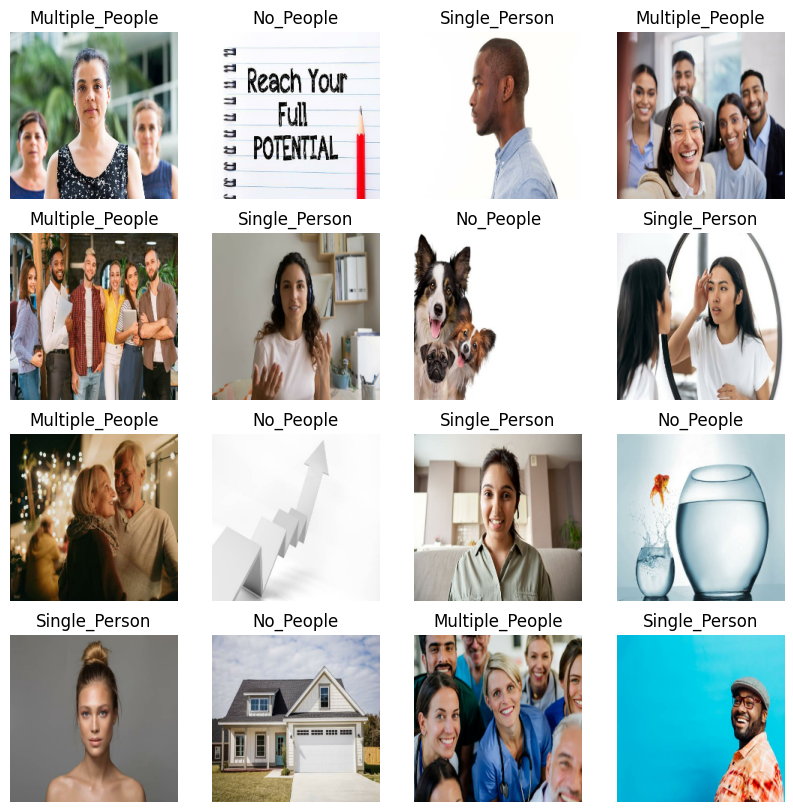

In [37]:
print('Predictions:\n', p)
print('Labels:\n', list(label_batch))
print('Confidence:\n',confidence)

plt.figure(figsize=(10, 10))
for i in range(16):
  ax = plt.subplot(4, 4, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title(class_names[p[i]])
  plt.axis("off")


### Now testing on some images from outside these datasets

In [38]:
def make_prediction(testing_image_path):
    image_loaded_2 = tf.keras.utils.load_img(testing_image_path, 
                                            target_size=(224, 
                                                        224))
    img = np.array(image_loaded_2)
    score2 = tf.nn.softmax(final_model.predict(img[None,:,:]))
    plt.imshow(image_loaded_2)
    plt.title(class_names[np.argmax(score2)])
    print('confidence : ',np.max(score2)*100)
    print('Predicted class : ',class_names[np.argmax(score2)])

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
confidence :  99.99643564224243
Predicted class :  Multiple_People


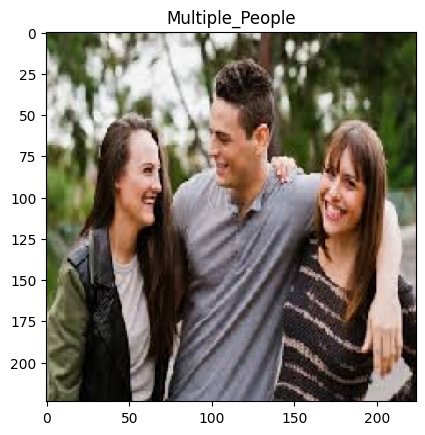

In [39]:
make_prediction('practise\multiple_people_1.jpeg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
confidence :  98.98170232772827
Predicted class :  Multiple_People


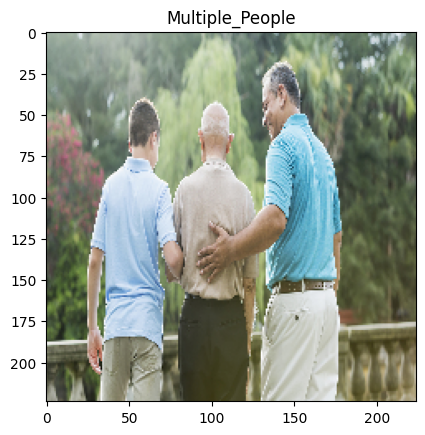

In [40]:
make_prediction('practise\multiple_people_2.jpeg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
confidence :  99.964439868927
Predicted class :  No_People


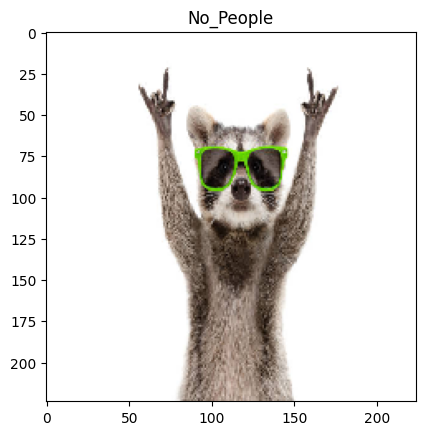

In [41]:
make_prediction('practise/no_people_2.jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
confidence :  100.0
Predicted class :  No_People


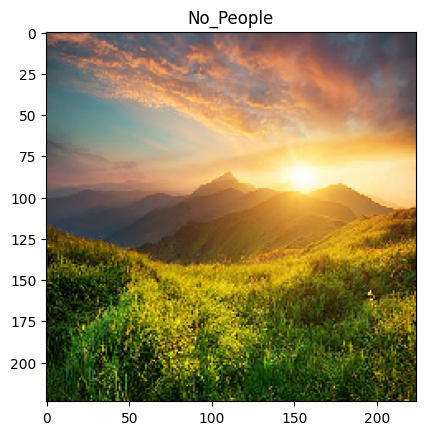

In [42]:
make_prediction('practise/no_people_1.jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
confidence :  94.35958862304688
Predicted class :  Single_Person


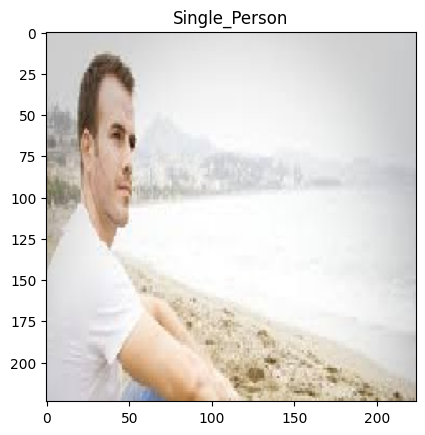

In [44]:
make_prediction('practise/single_person_1.jpeg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
confidence :  99.99860525131226
Predicted class :  Single_Person


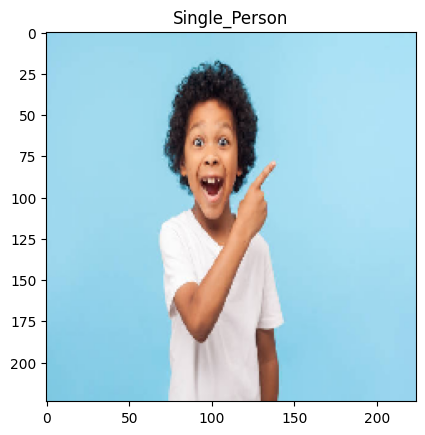

In [46]:
make_prediction('practise/single_person_3.jpg')

 But I have noticed that for some images in which even though a single person is present in them they are predicted as "Multiple People" or "No People" by my model due to the background effect/ multiple objects

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
confidence :  85.2548897266388
Predicted class :  Multiple_People


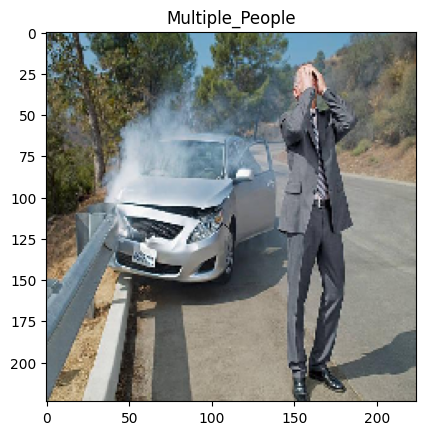

In [47]:
make_prediction('practise/Extra_Images/1 (17).jpg')

So for such cases I have used "rembg" library to remove the background and perform cross checking before giving the final prediction

In [53]:
from rembg import remove
from PIL import Image 
import io

In [54]:
def cross_checking(testing_image_path):
    input = Image.open(testing_image_path) 
    
    # # Removing the background from the given Image 
    output = remove(input) 
    
    #Saving the image in the given path 
    # output.save(output_path)
    image_bytes = io.BytesIO()
    output.save(image_bytes, format='PNG')
    image_loaded_2 = Image.open(image_bytes).resize((224, 224))
    img = np.array(image_loaded_2)

    # Ensure the image has 3 channels
    if img.shape[-1] == 4:
        img = img[:, :, :3]
    score2 = tf.nn.softmax(final_model.predict(img[None,:,:]))
    p = np.argmax(score2)
    return [p,score2]

In [143]:
def make_prediction2(testing_image_path):
    image_loaded_2 = tf.keras.utils.load_img(testing_image_path, 
                                            target_size=(224, 
                                                        224))
    img = np.array(image_loaded_2)
    score2 = tf.nn.softmax(final_model.predict(img[None,:,:]))
    predict_index = np.argmax(score2)
    final_predict = predict_index
    final_score = score2
    if(predict_index==0) : 
     # if the predicted image is multiple people we cross check whether it may be single person
      [cross_predict_index,score] = cross_checking(testing_image_path)
      final_predict = cross_predict_index if (cross_predict_index == 2 and np.max(score)>=np.max(score2)) else predict_index
      final_score = score if (cross_predict_index == 2 and np.max(score)>=np.max(score2)) else score2
    plt.imshow(image_loaded_2)
    plt.title(class_names[final_predict])
    print('confidence : ',np.max(final_score)*100)
    print('Predicted class : ',class_names[final_predict])
    return final_predict

Now just checking and comparing results from both make_prediction() and make_prediction2()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
confidence :  85.2548897266388
Predicted class :  Multiple_People


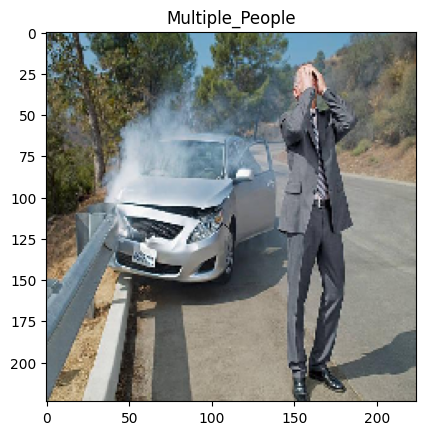

In [132]:
make_prediction('practise/Extra_Images/1 (17).jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
confidence :  97.38137722015381
Predicted class :  Single_Person


2

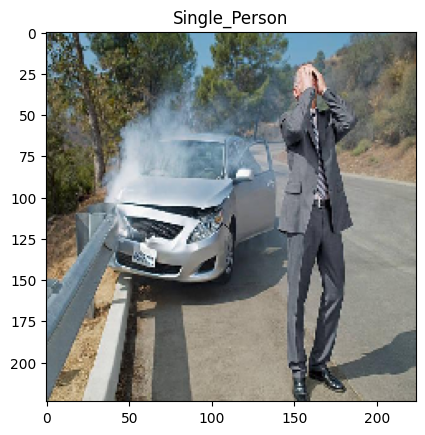

In [144]:
make_prediction2('practise/Extra_Images/1 (17).jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
confidence :  97.77486324310303
Predicted class :  Multiple_People


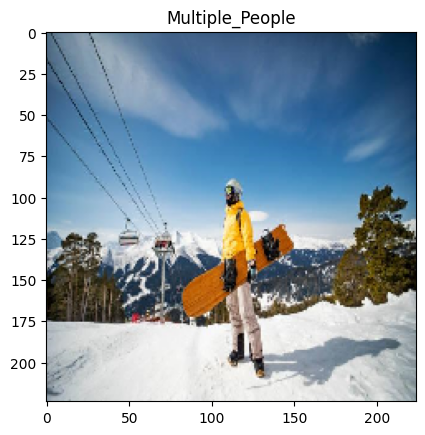

In [78]:
make_prediction('practise/Extra_Images/1 (10).png')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
confidence :  99.56600069999695
Predicted class :  Single_Person


2

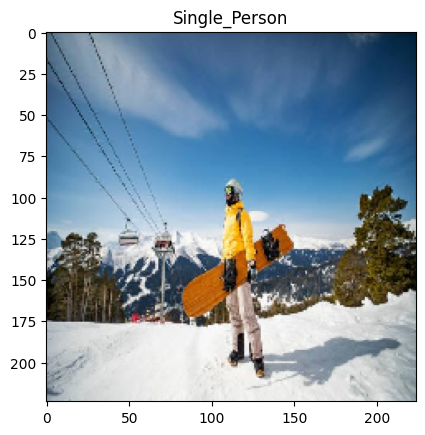

In [145]:
make_prediction2('practise/Extra_Images/1 (10).png')

I made a more generalized test dataset and tried running the make_predictions2() on it to check its working

In [80]:
test_dir = '.\\practise\\images\\People\\data_sets_2\\test_dataset'
test_dir = pathlib.Path(test_dir)

In [81]:
image_count = len(list(test_dir.glob('*/*.jpg')))
print(image_count)

3597


In [82]:
multi = list(test_dir.glob('Multiple_People/*'))
singi = list(test_dir.glob('Single_Person/*'))
no_people = list(test_dir.glob('No_People/*'))

In [83]:
people_img_dict = {
    'Multiple_People': multi[:240],
    'Single_Person' : singi[:240],
    'No_People' : no_people[:240]
}
people_labels_dict = {
    'Multiple_People':0,
    'Single_Person' : 2,
    'No_People':1
}

In [84]:
X, y = [], []

for name, images in people_img_dict.items():
    for image in images:
        X.append(str(image))
        #print(len(X))
        y.append(people_labels_dict[name])

In [85]:
from sklearn.utils import shuffle
X_test, y_test = shuffle(X, y, random_state=2)

In [135]:
count = 0    

In [136]:
print(count)

0


In [137]:
wrong_predictions=[]

In [138]:
for i in range(len(y_test)):
    print(i)
    predict = make_prediction2(X_test[i])
    if predict==y_test[i]:
        count= count + 1
    else : 
        wrong_predictions.append([X_test[i],y_test[i],predict])

0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
6
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
7
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
8
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
9
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
11
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
12
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
13
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
14
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
15
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
16
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
17
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
18
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
19
1/1 ━━━━━━━━━━

In [139]:
print(count*100/len(y_test))

95.27777777777777


In [140]:
len(wrong_predictions)

34

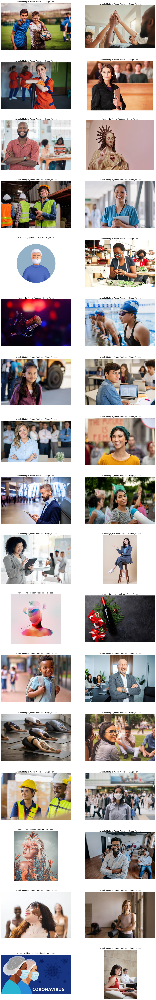

In [142]:
plt.figure(figsize=(20, 130))
for i in range(34):
  ax = plt.subplot(17, 2, i + 1)
  img = Image.open(wrong_predictions[i][0])
  #print(i+1,wrong_predictions[i][0])
  plt.imshow(img)
  plt.title("Actual : "+str(class_names[wrong_predictions[i][1]])+" Predicted : "+str(class_names[wrong_predictions[i][2]]))
  plt.axis("off")

1) As we can see most of the wrong predictions are in case of images containing multiple people images when most the people present in them are of not clearly distinguishable from the background. 

2) In case of single person images most of the wrong predictions (not actually wrong) occur only if that person is some animated character or a painting etc.

3) There are some wrong predictions in the no people images as well due to the fact that the orginal model which I am using before cross checking has an accuracy of only around 97%.

## Conclusion :
Since our main focus is on "Single Person" images which needs to be passed on to the second model for posture detection I decided on using the make_prediction2() function with rembg cross checking as it gives better performance in case of identifying the "Single person" images.